# Solving the Dual Mot with Neural Networks

Import the packages

In [1]:
%reload_ext autoreload
%autoreload 2
from robust_pricing.deePricing import *
from robust_pricing.path_generators import BinomialTree, Uniform, Gaussian, GaussianMartingale, UniformMartingale
import numpy as np

import pandas as pd
import yfinance as yf
import datetime

import os

from helper import *

We start by using data of two options. We use AAPL options with maturity 2023-06-16 and 2023-06-21.

## 2.1 The option portfolios

In [2]:
from datetime import date, timedelta
# str()
OPTION_DATA_BASE = f'../data/options_data/frozen_date=2023-05-17'

In [3]:
MATURITY_DATES = ['2023-05-19', '2023-06-23', '2023-07-21', '2023-08-18', '2023-09-15', '2023-10-20', '2023-11-17', '2023-12-15']

In [4]:
path_length = 2

In [5]:
# tk = yf.Ticker('AAPL')
# md = tk.history_metadata
# spot_price = md['chartPreviousClose']
spot_price = 160
from_data_local = True


def create_option_objs_from_yahoo(maturity_date, ticker='AAPL', from_data_local=True):
    if from_data_local:
        calls = pd.read_csv(os.path.join(OPTION_DATA_BASE, f'maturity_date={maturity_date}', f'calls.csv'))
        puts = pd.read_csv(os.path.join(OPTION_DATA_BASE, f'maturity_date={maturity_date}', f'puts.csv'))
    
    else:
        tk = yf.Ticker(ticker)
        md = tk.history_metadata
        
        chain = tk.option_chain(date=maturity_date)
        calls = chain.calls
        puts = chain.puts

    needed_columns = ['bid', 'strike', 'lastPrice', 'ask', 'openInterest', 'volume', 'contractSize']
#     needed_columns = ['strike', 'lastPrice']
    calls_objs = [
        Call(
            strike=x[1].pop('strike'),
            price=x[1].pop('lastPrice'),
            bid=x[1].pop('bid'),
            ask=x[1].pop('ask'),
            **x[1]
        ) for x in calls[needed_columns].iterrows()
    ]
    puts_objs = [
        Put(
            strike=x[1].pop('strike'),
            price=x[1].pop('lastPrice'),
            bid=x[1].pop('bid'),
            ask=x[1].pop('ask'),
            **x[1]
        ) for x in puts[needed_columns].iterrows()
    ]
    
    return calls_objs, puts_objs


# observed_times = [i * (len(MATURITY_DATES) // path_length) for i in range(1, path_length + 1)]
observed_times = [2, 3]

maturity_dates = [MATURITY_DATES[min(i, len(MATURITY_DATES)-1)] for i in observed_times] 

# Build the OneMaturityOptionPortfolio objects

option_portfolios = []
for m in maturity_dates:
    o = OneMaturityOptionPortfolio(*create_option_objs_from_yahoo(m, from_data_local=from_data_local))
    option_portfolios.append(o)

option_portfolio = DiagonalOptionPortfolio(option_portfolios)
    

## 2.2 The exotic option

In this case we will use a simple call option:

In [6]:
def target_function(x):
    K = 200
    if isinstance(x, torch.Tensor):
        return torch.relu(x.select(1, -1) - K)
    else:
        return max(x[-1] - K, 0)

In [7]:
maturity_dates

['2023-07-21', '2023-08-18']

In [8]:
option_portfolio.option_portfolios[-1].calls

[Call(strike=50.0, price=124.6, bid=120.8, ask=123.2),
 Call(strike=55.0, price=102.18, bid=112.5, ask=113.15),
 Call(strike=60.0, price=112.64, bid=111.9, ask=113.15),
 Call(strike=65.0, price=88.45, bid=88.65, ask=89.15),
 Call(strike=70.0, price=95.75, bid=102.8, ask=103.3),
 Call(strike=75.0, price=98.55, bid=97.8, ask=98.15),
 Call(strike=80.0, price=94.22, bid=93.05, ask=93.4),
 Call(strike=85.0, price=89.33, bid=88.1, ask=88.4),
 Call(strike=90.0, price=80.29, bid=83.05, ask=83.65),
 Call(strike=95.0, price=78.4, bid=78.1, ask=78.4),
 Call(strike=100.0, price=74.91, bid=73.3, ask=73.6),
 Call(strike=105.0, price=56.28, bid=62.9, ask=63.7),
 Call(strike=110.0, price=65.55, bid=63.35, ask=64.0),
 Call(strike=115.0, price=59.2, bid=58.4, ask=58.85),
 Call(strike=120.0, price=53.5, bid=53.6, ask=54.15),
 Call(strike=125.0, price=49.43, bid=49.0, ask=49.3),
 Call(strike=130.0, price=44.1, bid=44.25, ask=44.45),
 Call(strike=135.0, price=39.76, bid=39.5, ask=39.75),
 Call(strike=140.0

In [9]:
option_portfolio.option_portfolios[-1].puts

[Put(strike=50.0, price=0.01, bid=0.00985, ask=0.01),
 Put(strike=55.0, price=0.01, bid=0.00985, ask=0.01),
 Put(strike=60.0, price=0.01, bid=0.00985, ask=0.02),
 Put(strike=65.0, price=0.02, bid=0.01, ask=0.02),
 Put(strike=70.0, price=0.03, bid=0.02, ask=0.03),
 Put(strike=75.0, price=0.03, bid=0.02, ask=0.03),
 Put(strike=80.0, price=0.04, bid=0.03, ask=0.05),
 Put(strike=85.0, price=0.06, bid=0.05, ask=0.07),
 Put(strike=90.0, price=0.09, bid=0.07, ask=0.08),
 Put(strike=95.0, price=0.08, bid=0.09, ask=0.1),
 Put(strike=100.0, price=0.12, bid=0.12, ask=0.13),
 Put(strike=105.0, price=0.17, bid=0.16, ask=0.17),
 Put(strike=110.0, price=0.22, bid=0.21, ask=0.22),
 Put(strike=115.0, price=0.29, bid=0.27, ask=0.28),
 Put(strike=120.0, price=0.36, bid=0.35, ask=0.37),
 Put(strike=125.0, price=0.46, bid=0.45, ask=0.47),
 Put(strike=130.0, price=0.6, bid=0.61, ask=0.62),
 Put(strike=135.0, price=0.79, bid=0.79, ask=0.81),
 Put(strike=140.0, price=1.05, bid=1.05, ask=1.08),
 Put(strike=145

## 2.3 We need to choose a model $\theta$ to sample from

In [10]:
maturity_dates

['2023-07-21', '2023-08-18']

In [11]:
sampling_models = [
        Uniform(path_length, mean=spot_price, variance=400 ** 2),
        Gaussian(path_length, mean=spot_price, variance=60 ** 2),
        GaussianMartingale(path_length, mean=spot_price, variance=50 ** 2),
        UniformMartingale(path_length, mean=spot_price, variance=200 ** 2),
    ]
gm = sampling_models[2]
data = gm(1000)

In [12]:
hist_2d(data, 0, 1)

## 2.4 Create the hedging strategies

In [13]:
from math import prod
s = 0
for par in h_sup.parameters():
    s += prod(list(par.shape))
s

NameError: name 'h_sup' is not defined

## 2.5 Optimize

In [14]:
number_of_observations=7000
gamma = 2000
no_trading_strategy = True

# from copy import deepcopy
# HedgingStrategy.DEFAULT_COVERGENCE_TOLERANCE = 1e-5
# OneMaturityOptionPortfolio.DEFAULT_SIMPLEX_PENALIZATION_FACTOR = 100

# simplex_penalization_factor = 100
number_of_episodes = 40000

trading_kwargs=dict(num_layers=5, width_layers=100)

h_sup = HedgingStrategy(
    option_portfolio=deepcopy(option_portfolio),
    target_function=target_function,
    super_hedge=True,
    trading_kwargs=trading_kwargs,
    no_trading_strategy=no_trading_strategy,
#     simplex_penalization_factor=simplex_penalization_factor
)
h_sub = HedgingStrategy(
    option_portfolio=deepcopy(option_portfolio),
    target_function=target_function,
    super_hedge=False,
    trading_kwargs=trading_kwargs,
    no_trading_strategy=no_trading_strategy,
#     simplex_penalization_factor=simplex_penalization_factor
)


h_sup.penalization_function.gamma = gamma
h_sub.penalization_function.gamma = gamma

h_sup.optimize(
    generator=gm, 
    number_of_observations=number_of_observations, 
    number_of_episodes=number_of_episodes,
)

h_sub.optimize(
    generator=gm, 
    number_of_observations=number_of_observations, 
    number_of_episodes=number_of_episodes,
)

epoch:500-training_loss_function:110.32577514648438-portfolio_value:73.63272094726562-replication_error:36.69305419921875-cumulative_portfolio_value:73.63272094726562-execution_time:3.266073703765869-
epoch:1000-training_loss_function:158.17649841308594-portfolio_value:75.19694519042969-replication_error:82.97955322265625-cumulative_portfolio_value:75.19694519042969-execution_time:6.480808973312378-
epoch:1500-training_loss_function:76.98796844482422-portfolio_value:75.45562744140625-replication_error:1.5323410034179688-cumulative_portfolio_value:73.63890075683594-execution_time:9.745027780532837-
epoch:2000-training_loss_function:75.21078491210938-portfolio_value:75.0858154296875-replication_error:0.124969482421875-cumulative_portfolio_value:75.0858154296875-execution_time:12.816737651824951-
epoch:2500-training_loss_function:74.50624084472656-portfolio_value:74.315673828125-replication_error:0.1905670166015625-cumulative_portfolio_value:74.315673828125-execution_time:16.1226058006286

epoch:20500-training_loss_function:-142.29100036621094-portfolio_value:-145.031982421875-replication_error:2.7409820556640625-cumulative_portfolio_value:-167.66954040527344-execution_time:176.17113280296326-
epoch:21000-training_loss_function:-167.17578125-portfolio_value:-167.88169860839844-replication_error:0.7059173583984375-cumulative_portfolio_value:-170.89898681640625-execution_time:181.26931381225586-
epoch:21500-training_loss_function:-171.43994140625-portfolio_value:-173.1466064453125-replication_error:1.7066650390625-cumulative_portfolio_value:-174.463134765625-execution_time:186.37618589401245-
epoch:22000-training_loss_function:-174.5131378173828-portfolio_value:-176.73072814941406-replication_error:2.21759033203125-cumulative_portfolio_value:-177.80340576171875-execution_time:191.56819677352905-
epoch:22500-training_loss_function:-121.55061340332031-portfolio_value:-142.3922882080078-replication_error:20.8416748046875-cumulative_portfolio_value:-181.44149780273438-executio

epoch:500-training_loss_function:-49.67527770996094-portfolio_value:-27.550018310546875-replication_error:22.125259399414062-cumulative_portfolio_value:-27.550018310546875-execution_time:3.413613796234131-
epoch:1000-training_loss_function:-4.396349906921387-portfolio_value:-3.6191635131835938-replication_error:0.777186393737793-cumulative_portfolio_value:-3.6191635131835938-execution_time:6.5191450119018555-
epoch:1500-training_loss_function:0.9036309719085693-portfolio_value:1.4811668395996094-replication_error:0.57753586769104-cumulative_portfolio_value:1.7311019897460938-execution_time:9.842127799987793-
epoch:2000-training_loss_function:5.333323001861572-portfolio_value:6.178768157958984-replication_error:0.8454451560974121-cumulative_portfolio_value:6.661651611328125-execution_time:13.50612998008728-
epoch:2500-training_loss_function:8.899374961853027-portfolio_value:9.586471557617188-replication_error:0.6870965957641602-cumulative_portfolio_value:13.041709899902344-execution_tim

In [15]:
h_sup.visualize_training_status()

In [16]:
h_sub.visualize_training_status()

In [17]:
f = max(option_portfolio.option_portfolios[-1].calls, key=lambda x: x.strike==200)

In [18]:
h_sub.training_status.keys()

dict_keys(['epoch', 'training_loss_function', 'portfolio_value', 'replication_error', 'cumulative_portfolio_value', 'execution_time', 'total_execution_time', 'total_num_episodes', 'best_bound'])

portfolio_value
portfolio_value


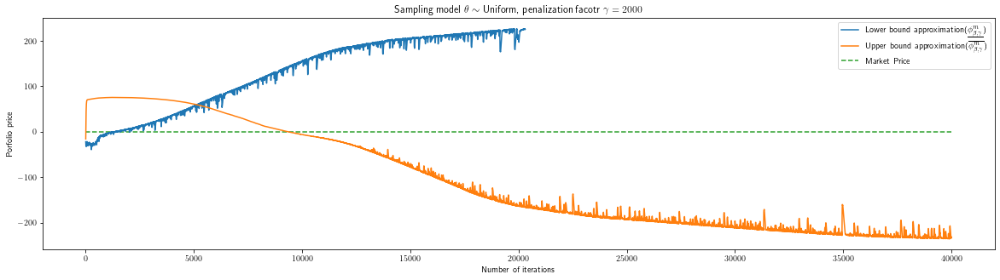

In [19]:
import matplotlib.pyplot as plt

base_path="/Users/davidcorredor/Desktop/Tesis_mate/tesis/manuscrit/Figures"

plt.rc('text', usetex=True)
ax = h_sub.visualize_training_status_plt(figsize=(20, 5), keys=['portfolio_value'], label="Lower bound approximation(" + r"$\underline{\phi^m_{\beta, \gamma}}$" + ")")
ax = h_sup.visualize_training_status_plt(ax=ax, keys=['portfolio_value'], color='tab:orange', label="Upper bound approximation(" + r"$\overline{\phi^m_{\beta, \gamma}}$" + ")")
ax.hlines(
    y=f.price,
    xmin=0,
    xmax=40000,
    linestyles='dashed',
    color='tab:green',
    label='Market Price'
)

plt.title(r"Sampling model $\theta\sim$ Uniform, penalization facotr $\gamma = 2000$")
plt.xlabel("Number of iterations")
plt.ylabel("Porfolio price")
plt.legend()
plt.savefig(os.path.join(base_path, "AAPL-divergence.png"), dpi=300)

                                         

In [20]:
for option in h_sup.option_portfolio.option_portfolios:
    print(option.simplex_penalization_factor)
    for i in option.parameters():
        print(torch.sum(i))
        print(i)

    print(option.simplex_penalization())

100
tensor(1.0014, grad_fn=<SumBackward0>)
Parameter containing:
tensor([[ 1.4408e-01,  7.3387e-01,  4.9622e-02,  8.6420e-02,  4.5089e-04,
          1.2933e-01,  8.0651e-02,  3.3531e-02, -7.2385e-03, -3.0790e-02,
         -3.1903e-02,  3.9362e-02,  3.2392e-02, -4.1645e-02, -8.9710e-03,
         -4.1569e-02, -1.7155e-01, -1.1861e-01, -2.3534e-01, -2.4252e-01,
         -2.9076e-01, -2.2999e-01, -3.4326e-01, -3.0125e-01, -3.3394e-01,
         -4.1816e-01, -3.8751e-01, -1.8087e-01,  5.3520e-02,  3.3164e-02,
          4.6855e-02,  1.1352e-01,  5.1353e-02,  1.4724e-01,  5.5496e-02,
          1.8992e-01,  4.9844e-02,  1.3837e-01,  3.9904e-02,  1.4146e-01,
          5.7698e-02,  1.5350e-01,  2.1564e-01,  1.9884e-01, -1.7188e-01,
         -2.4967e-03, -1.6574e-01, -1.7552e-01, -1.4869e-01,  8.9024e-03,
          1.2308e-01,  9.8427e-02,  8.1225e-02,  1.3213e-01,  9.3337e-02,
          5.9891e-02,  5.1947e-02,  1.3822e-01,  8.8192e-02,  1.1292e-01,
          6.8287e-02,  1.0382e-01,  2.6659e-01,

In [21]:
f.price

0.51

tensor(-232.1431, grad_fn=<AddBackward0>)


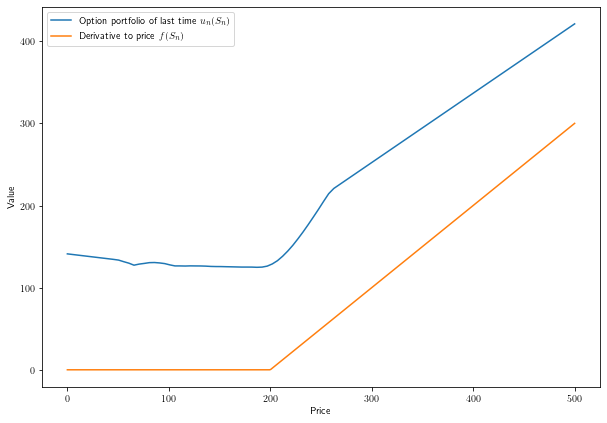

In [22]:
index = 1
port = h_sup

print(port.value)

ax = port.option_portfolio.option_portfolios[-index].visualize_payoff(plot_minus_value=False, label=r"Option portfolio of last time $u_n(S_n)$")
ax = f.to_quantlib_object().visualizer.payoff(ax=ax, x_low= 0, x_high=500, label=r"Derivative to price $f(S_n)$")

plt.legend()
plt.savefig("h_sup_n_payoff.png", dpi=300)

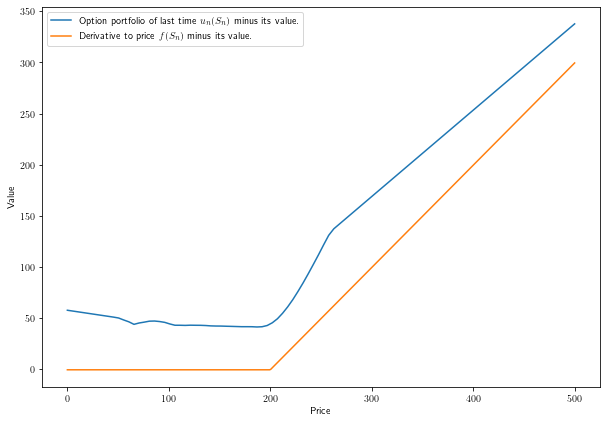

In [23]:
ax = port.option_portfolio.option_portfolios[-index].visualize_payoff(plot_minus_value=True, plot_pay_off = False, label=r"Option portfolio of last time $u_n(S_n)$ minus its value.")
ax = f.to_quantlib_object().visualizer.payoff(ax=ax, x_low= 0, x_high=500, label=r"Derivative to price $f(S_n)$ minus its value.", value=f.price)

plt.legend()
plt.savefig("h_sup_n_payoff_minus_value.png", dpi=300)

In [24]:
# h_sup.option_portfolio.option_portfolios[-1].portfolio
# h_sup.option_portfolio.option_portfolios[-2].value
value = 0
for o, v in port.option_portfolio.option_portfolios[-index].portfolio.items():
    value += max(0, v) * o.ask + min(0, v) * o.bid
#     print(o)
#     print(max(0, v) * o.ask + min(0, v) * o.bid, "=", max(0, v) + min(0, v),"*" , max(0, v>0) * o.ask + min(0, -int(v<=0)) * o.bid)

print(value, port.option_portfolio.option_portfolios[-index].value)


83.41630114472622 tensor(83.4163, grad_fn=<SubBackward0>)


In [25]:
port.option_portfolio.option_portfolios[-index].portfolio

{Call(strike=50.0, price=124.6, bid=120.8, ask=123.2): 0.045318894,
 Call(strike=55.0, price=102.18, bid=112.5, ask=113.15): 0.34044424,
 Call(strike=60.0, price=112.64, bid=111.9, ask=113.15): 0.0475094,
 Call(strike=65.0, price=88.45, bid=88.65, ask=89.15): 0.99556845,
 Call(strike=70.0, price=95.75, bid=102.8, ask=103.3): 0.017186416,
 Call(strike=75.0, price=98.55, bid=97.8, ask=98.15): 0.1548331,
 Call(strike=80.0, price=94.22, bid=93.05, ask=93.4): 0.04053319,
 Call(strike=85.0, price=89.33, bid=88.1, ask=88.4): 0.02359763,
 Call(strike=90.0, price=80.29, bid=83.05, ask=83.65): 0.0014741913,
 Call(strike=95.0, price=78.4, bid=78.1, ask=78.4): 0.020233454,
 Call(strike=100.0, price=74.91, bid=73.3, ask=73.6): 0.120725736,
 Call(strike=105.0, price=56.28, bid=62.9, ask=63.7): 0.4008728,
 Call(strike=110.0, price=65.55, bid=63.35, ask=64.0): -0.04065485,
 Call(strike=115.0, price=59.2, bid=58.4, ask=58.85): 0.11128652,
 Call(strike=120.0, price=53.5, bid=53.6, ask=54.15): -0.0085122

In [26]:
from functools import reduce
import math
from fractions import Fraction


def lcm(*values):
    def lcm_2(a, b):
        return abs(a * b) // math.gcd(a, b)
    
    return reduce(lcm_2, values, 1)


def portfolio_multipliter(weights, round_= None):
    if round_:        
        fractional_weights_denominators = list(map(lambda x: Fraction(str(round(x, round_))).limit_denominator().denominator, weights))
    else:
        fractional_weights_denominators = list(map(lambda x: Fraction(str(x)).limit_denominator().denominator, weights))
    
    return lcm(*fractional_weights_denominators)
                    

In [27]:
weigths = list(port.option_portfolio.option_portfolios[-index].portfolio.values())

In [28]:
round_=4
ii = portfolio_multipliter(weigths, round_=round_)
ii

10000

In [29]:
ii

10000

In [30]:
new_weights = list(map(lambda x: round(round(x, round_) * ii, 0), weigths))

In [31]:
from copy import deepcopy
new_port = deepcopy(port.option_portfolio.option_portfolios[-index].portfolio)
divider = 900

q_port = None
for obj, v in zip(new_port.keys(), new_weights):
    if q_port is None: 
        q_port = int(v / divider) * obj.to_quantlib_object()
    else:
        q_port += int(v / divider) * obj.to_quantlib_object()
    new_port[obj] = int(v / divider)
# new_port

In [32]:
def value_from(portfolio_dict):
    return sum(
        max(v, 0) * k.ask + min(v, 0) * k.bid for k, v in portfolio_dict.items()
    )

In [ ]:
print(value_from(new_port))
q_port.visualizer.payoff(value_from(new_port))
q_port.visualizer.payoff()

In [ ]:
for obj, w in new_port.items():
    if w != 0:
        print("#"*10,"\n", obj, w)
        print(obj.volume, obj.openInterest,)
    #     print(w >= obj.volume)
        missing_vol = max(abs(w) - obj.volume, 0)
        if missing_vol != 0:
            print("missing volume: ", missing_vol)
        print("#"*10,"\n")
    

In [ ]:
port = h_sup.option_portfolio.option_portfolios[-1]
list(map(lambda x: (x._bid, x.price, x._ask, x._bid <= x._ask ), h_sup.option_portfolio.option_portfolios[-1].calls))
# port.portfolio